# Assignment 2: Enhancing Awareness and Engagement with Protected Areas in the UK: A Geovisualization Approach

# Contents

1. [Introduction](#1-Introduction)  
   - [Figure 1: Protected Inland Areas](#Figure-1:-Protected-Inland-Areas)  
   - [Figure 2: Marine Protected Areas](#Figure-2:-Marine-Protected-Areas)  
   - [Figure 3: Proportion of Local Authority Land Covered by Protected Areas](#Figure-3:-Proportion-of-Local-Authority-Land-Covered-by-Protected-Areas)  
2. [Data Sources Presentation](#2-Data-Sources-Presentation)  
3. [Dashboard Rationale](#3-Dashboard-Rationale)  
4. [Dashboard's Interactivity and design choices](#4-Dashboards-Interactivity-and-design-choices)  
5. [Inland Dashboard (Tab 1)](#5-Inland-Dashboard-(Tab-1))  
   - [5.1 Preparing the Data](#51-Preparing-the-Data)  
   - [5.2 Widgets and Filters](#52-Widgets-and-Filters)  
   - [5.3 Folium Map](#53-Folium-Map)  
   - [5.4 Charts and Data](#54-Charts-and-Data)  
     - [5.4.1 Indicator](#541-Indicator)  
     - [5.4.2 Pie Chart](#542-Pie-Chart)  
   - [5.5 Information and Icons](#55-Information-and-Icons)  
     - [5.5.1 Information of the parks](#551-Information-of-the-parks)  
     - [5.5.2 Foto](#552-Foto)  
   - [5.6 In Land Tab Layout](#56-In-Land-Tab-Layout)  
6. [Dashboard Marine (Tab 2)](#6-Dashboard-Marine-(Tab-2))  
   - [6.1 Preparing the data](#61-Preparing-the-data)  
   - [6.2 Widgets](#62-Widgets)  
   - [6.3 Folium Map](#63-Folium-Map)  
   - [6.4 Informations](#64-Informations)  
   - [6.5 Final Layout (Tab 2 Waters)](#65-Final-Layout-(Tab-2-Waters))  
7. [Help Page (Tab 3)](#7-Help-Page-(Tab-3))  
   - [7.1 Help page widget](#71-Help-page-widget)  
   - [7.2 Help page Layout](#72-Help-page-Layout)  
8. [Final Dashboard](#8-Final-Dashboard)  
   - [*Exporting Dashboard*](#Exporting-Dashboard)  
9. [Conlcusion](#9-Conclusion)  
10. [References](#10-References)

In [1]:
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
import matplotlib.patches as legendp
import matplotlib.ticker as mticker

#Dashboar

from folium.plugins import MarkerCluster
import folium

import geopandas as gpd
import hvplot.pandas
import panel as pn

#Pie chart
from math import pi
from bokeh.palettes import Category20c, Category20
from bokeh.plotting import figure
from bokeh.transform import cumsum

# Serch Photo Park
from duckduckgo_search import DDGS

pn.extension()

# 1 Introduction

Protected areas are defined as geographical spaces that are recognised, dedicated, and managed through legal or other means to conserve nature and biodiversity [8]. They play a crucial role in preserving ecosystem services supporting local livelihoods through food provision, climate regulation, and recreation (tourism) [9, 11].

The establishment of protected areas has expanded significantly, both geographically and conceptually, driven by governments, institutions, and local communities [11]. This growth has been influenced by rising concerns over environmental degradation [ibid].

Globally, there are over 164,000 legally designated national protected areas, covering 28.4 million square kilometres or 5.6% of the Earth’s surface. In the UK alone, there are 11,976 protected areas. Of the country’s total, 28.45% of terrestrial and inland waters are protected, as shown in Figure 1, while 46.76% of the marine area is under protection, as illustrated in Figure 2 [10].

Despite their importance, biodiversity continues to face significant threats from overexploitation through activities like logging and overfishing [8]. While sometimes driven by bad faith, these actions more often result from a lack of awareness about the existence and significance of protected sites [2]. Despite most regions of the UK being covered by protected areas, as shown in Figure 3, with some cities having more than half of their territory protected, public awareness remains limited [ibid].

Effective conservation requires proper management and greater involvement from local populations [8], as social influences also play a critical role in the success of biodiversity protection efforts [2]. Through geovisualization, this work aims to help increase public awareness of protected areas in the UK and support their effective management. This will be achieved by developing an interactive dashboard that presents spatial and statistical information in an accessible format, allowing users to explore the distribution, status, and key characteristics of protected areas across various cities in the United Kingdom.

## Figure 1: Protected Inland Areas

In [2]:
# Importing protected area as parks0 and administrative boundadies
parks0 = gpd.read_file("../WDPA_WDOECM_Mar2025_Public_GBR_shp/WDPA_WDOECM_Mar2025_Public_GBR_shp_0.zip")
uk_countries = gpd.read_file("../Countries_December_2024_Boundaries_UK_BFC_6983126662299524946.zip") # Countries
uk_countries = uk_countries.to_crs(epsg=4326) # Geo

#parks0.head()
#parks0.unique()

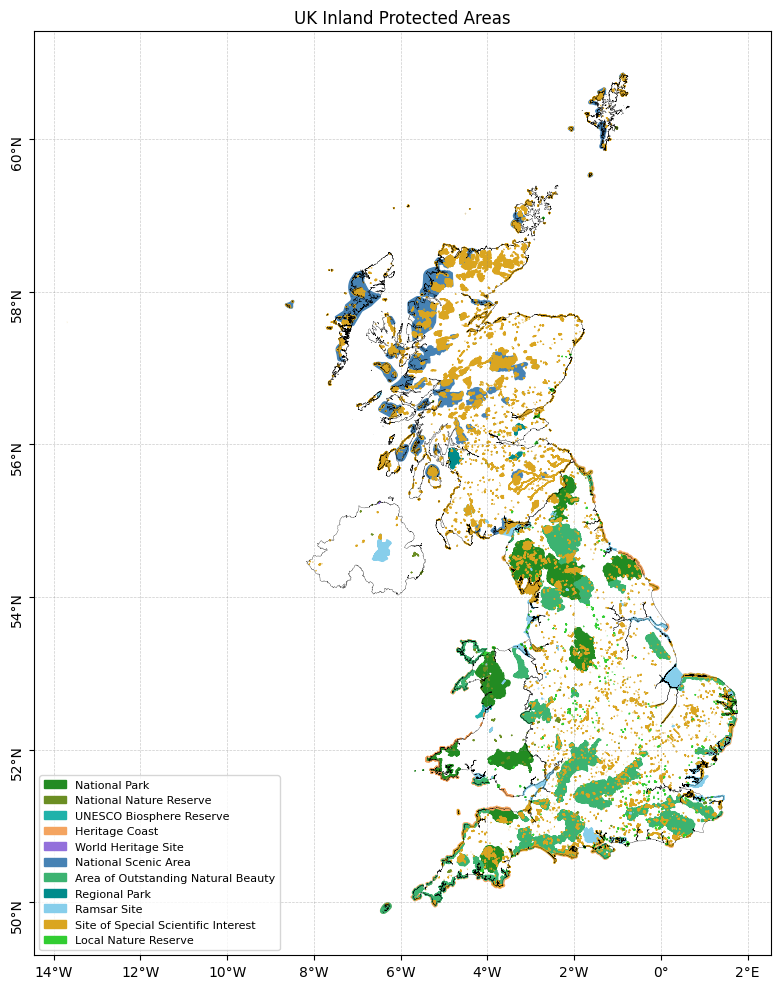

In [3]:
# Data pre processing
# After studying the data, some names were repeated, so mapping to unique names
parks0['DESIG_U'] = parks0['DESIG'].str.strip().str.lower()
unique_name = {
    'national park': 'National Park',
    'national nature reserve': 'National Nature Reserve',
    'unesco-mab biosphere reserve': 'UNESCO Biosphere Reserve',
    'heritage coast': 'Heritage Coast',
    'world heritage site (natural or mixed)': 'World Heritage Site',
    'national scenic area': 'National Scenic Area',
    'area of outstanding natural beauty': 'Area of Outstanding Natural Beauty',
    'regional park': 'Regional Park',
    'ramsar site, wetland of international importance': 'Ramsar Site',
    'area of special scientific interest': 'Site of Special Scientific Interest',
    'local nature reserve': 'Local Nature Reserve',
    'site of special scientific interest': 'Site of Special Scientific Interest',
    'site of special scientific interest (uk)': 'Site of Special Scientific Interest'
}
# Replacing old name with unique names
parks0['DESIG_U'] = parks0['DESIG_U'].replace(unique_name)

# Assigning appropriate colours for each park
colors = {
    'National Park': '#228B22',  # Forest Green
    'National Nature Reserve': '#6B8E23',  # Olive Drab
    'UNESCO Biosphere Reserve': '#20B2AA',# Light Sea Green
    'Heritage Coast': '#F4A460',# Sandy Brown
    'World Heritage Site': '#9370DB',# Medium Purple
    'National Scenic Area': '#4682B4',# Steel Blue
    'Area of Outstanding Natural Beauty': '#3CB371',# Medium Sea Green
    'Regional Park': '#008B8B',# Dark Cyan
    'Ramsar Site': '#87CEEB',# Sky Blue
    'Site of Special Scientific Interest': '#DAA520',# Goldenrod
    'Local Nature Reserve': '#32CD32'# Lime Green
}

#Ploating the chart


fig, ax = plt.subplots(1, 1, figsize=(12, 10))

# Ploting each categories
legend = []
for site, color in colors.items():
    parks0_site = parks0[parks0["DESIG_U"] == site]
    parks0_site.plot(ax=ax, color=color, edgecolor=color)
    legend.append(legendp.Patch(color=color, label=site))

uk_countries.plot(ax=ax, color="none", edgecolor="black", linewidth=0.2)

# Add legend
ax.legend(handles=legend, loc='lower left', fontsize=8, frameon=True)
#grids
ax.grid(True, which='major', linestyle='--', linewidth=0.5, color='gray', alpha=0.4)

# Format the labels to be more legible
def format_lon(x, pos):
    if x <0:
        return f"{abs(x):.0f}°W"
    elif x > 0:
        return f"{x:.0f}°E"
    else:
        return "0°"
def format_lat(x, pos):
    if x < 0:
        return f"{abs(x):.0f}°S"
    elif x > 0:
        return f"{x:.0f}°N"
    else:
        return "0°"

ax.xaxis.set_major_locator(mticker.MultipleLocator(2))
ax.yaxis.set_major_locator(mticker.MultipleLocator(2))
ax.xaxis.set_major_formatter(mticker.FuncFormatter(format_lon))
ax.yaxis.set_major_formatter(mticker.FuncFormatter(format_lat))
ax.yaxis.set_tick_params(rotation=90)
plt.title("UK Inland Protected Areas")

plt.tight_layout()
plt.show()

## Figure 2: Marine Protected Areas

In [4]:
# Importing data with marine protected areas
parks2 = gpd.read_file("../WDPA_WDOECM_Mar2025_Public_GBR_shp/WDPA_WDOECM_Mar2025_Public_GBR_shp_2.zip")
protected_marine = parks2[parks2["MARINE"]!="0"].copy()
# Importing UK territorial water for context on marine protected ares
uk_waters = gpd.read_file("../eez.zip")

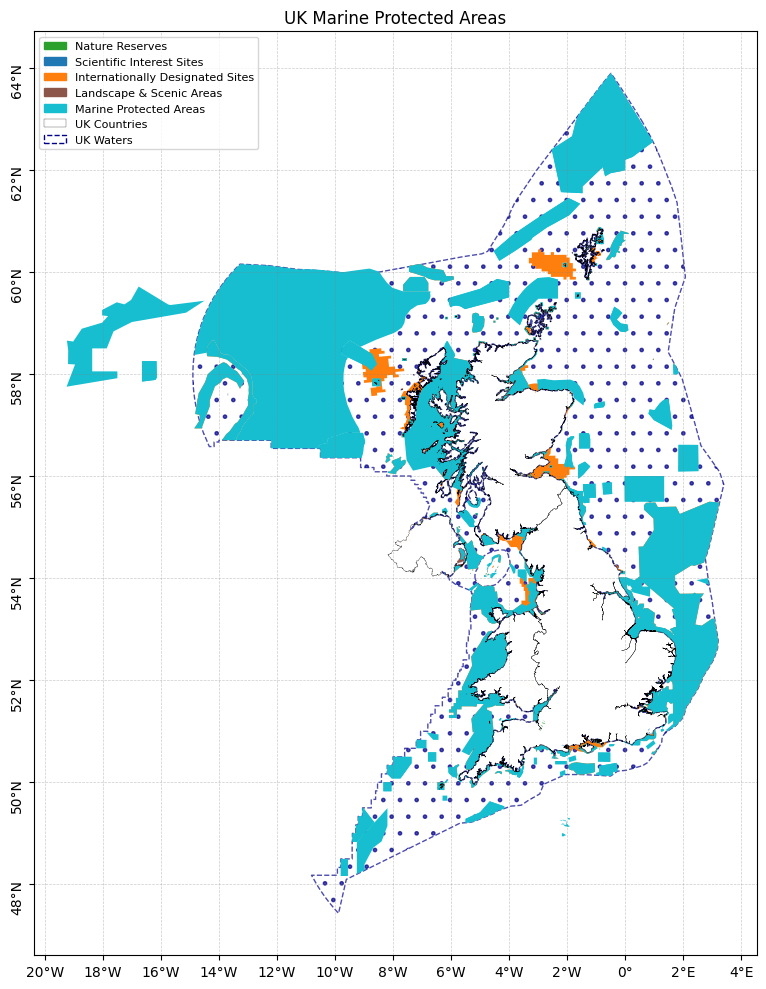

In [5]:
# Similar to land replacing with unique names
unique_names = {
    'Local Nature Reserve': 'Nature Reserves',
    'Ramsar Site, Wetland of International Importance': 'Internationally Designated Sites',
    'Site of Special Scientific Interest': 'Scientific Interest Sites',
    'National Nature Reserve': 'Nature Reserves',
    'World Heritage Site (natural or mixed)': 'Internationally Designated Sites',
    'Special Protection Area': 'Internationally Designated Sites',
    'Area of Outstanding Natural Beauty': 'Landscape & Scenic Areas',
    'Area of Special Scientific Interest': 'Scientific Interest Sites',
    'Marine Protected Area (OSPAR)': 'Marine Protected Areas',
    'Marine Conservation Zone': 'Marine Protected Areas',
    'Community Marine Conservation Area': 'Marine Protected Areas',
    'Nature Conservation Marine Protected Area': 'Marine Protected Areas',
    'Nature Reserve': 'Nature Reserves',
    'Demonstration and Research Marine Protected Area': 'Marine Protected Areas',
    'UNESCO-MAB Biosphere Reserve': 'Internationally Designated Sites',
    'Emerald Network': 'Internationally Designated Sites'
}

colors = {
    'Nature Reserves': '#2ca02c',# Green
    'Scientific Interest Sites': '#1f77b4',# Blue
    'Internationally Designated Sites': '#ff7f0e',# Orange
    'Landscape & Scenic Areas': '#8c564b',# Brown
    'Marine Protected Areas': '#17becf'# Teal
}
protected_marine['DESIG_U'] = protected_marine['DESIG'].replace(unique_names)

# Plotting
fig, ax = plt.subplots(1,1, figsize = (12,10))

uk_waters.plot(ax=ax, facecolor="white", hatch=".",alpha=0.7, linestyle="--", edgecolor="darkblue")

legends = []
for site, color in colors.items():
    protected_marine_site = protected_marine[protected_marine['DESIG_U'] == site]
    protected_marine_site.plot(ax=ax, color=color, label=site)
    legends.append(legendp.Patch(color=color, label=site))

legends.append(legendp.Patch(facecolor="none", edgecolor="black",linewidth=0.2,label="UK Countries"))
legends.append(legendp.Patch(facecolor="white", hatch=".", linestyle="--", edgecolor="darkblue", label="UK Waters"))

uk_countries.plot(ax=ax,color="none", edgecolor="black", linewidth=0.2)


# Add legend
ax.legend(handles=legends, loc='upper left', fontsize=8, frameon=True)
#grids
ax.grid(True, which='major', linestyle='--', linewidth=0.5, color='gray', alpha=0.4)

# Format the tick labels for more legibe
def format_lon(x, pos):
    if x <0:
        return f"{abs(x):.0f}°W"
    elif x > 0:
        return f"{x:.0f}°E"
    else:
        return "0°"
def format_lat(x, pos):
    if x < 0:
        return f"{abs(x):.0f}°S"
    elif x > 0:
        return f"{x:.0f}°N"
    else:
        return "0°"

ax.xaxis.set_major_locator(mticker.MultipleLocator(2))
ax.yaxis.set_major_locator(mticker.MultipleLocator(2))
ax.xaxis.set_major_formatter(mticker.FuncFormatter(format_lon))
ax.yaxis.set_major_formatter(mticker.FuncFormatter(format_lat))
ax.yaxis.set_tick_params(rotation=90)
plt.title("UK Marine Protected Areas")
plt.tight_layout()
plt.show()

## Figure 3: Proportion of Local Authority Land Covered by Protected Areas

In [6]:
# Importing local authorities
uk_local_authority = gpd.read_file("../Local_Authority_Districts_May_2024_Boundaries_UK_BUC_3499872675230401373_1.zip")

In [7]:
# Both data sets have the column below deleting in one to avoid repeated columns and assigning the same projection.
protected_areas = parks0.drop(["LAD24NM","CTRY24NM","RGN24NM"], axis=1).to_crs(uk_local_authority.crs) #Same projecteon, same atribute

# Intersect protected areas with countries to find the intersected areas
intersected = gpd.overlay(uk_local_authority, protected_areas, how="intersection")

# Calculating  the intersected area
uk_local_authority["total_area_km2"] = uk_local_authority.geometry.area / (10**6)
intersected["protected_area_km2"] = intersected.geometry.area / (10**6)
# Summing the protected area per local authorities
protected_sum = intersected.groupby("LAD24NM")["protected_area_km2"].sum().reset_index()
# adding to local authorities
uk_local_authority = uk_local_authority.merge(protected_sum, on="LAD24NM", how="left")
uk_local_authority["protected_area_km2"] = uk_local_authority["protected_area_km2"].fillna(0)
# Calculating percentage
uk_local_authority["protected_perc"] = (uk_local_authority["protected_area_km2"] / uk_local_authority["total_area_km2"]) * 100

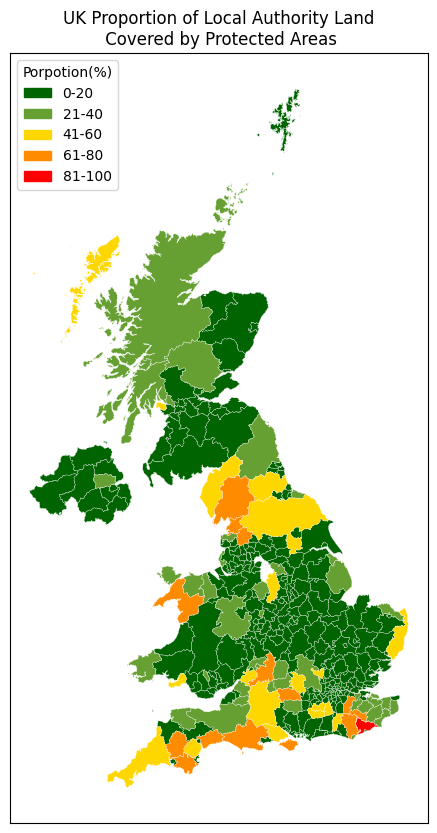

In [8]:
colors = {
    (0,20): "#006400", # Dark Green
    (21,40): "#66A032",# Olive Green
    (41,60): "#FFD700", # Yellow/Gold
    (61,80): "#FF8C00", # Orange
    (81,100): "#FF0000"  # Red
}

fig, ax = plt.subplots(1,1,figsize = (12,10))
legends = []
for percentage, color in colors.items():
  mi, ma = percentage
  uk_local_authority_p = uk_local_authority[(uk_local_authority["protected_perc"] >=mi) & (uk_local_authority["protected_perc"] <=ma)]
  uk_local_authority_p.plot(ax=ax, color=color,edgecolor="white",linewidth=0.2,label=f"{mi}-{ma}")
  legends.append(legendp.Patch(color=color, label=f"{mi}-{ma}"))
#uk_local_authority.plot(ax=ax,column="protected_perc", cmap="Reds",scheme="equal_interval", legend=True)
plt.legend(handles=legends,loc='upper left',title='Porpotion(%)',)

ax.set_xticks([])
ax.set_yticks([])
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
plt.title("UK Proportion of Local Authority Land\n Covered by Protected Areas")
plt.show()

# 2 Data Sources Presentation

The primary dataset, UK Protected Areas, was sourced from Protected Planet, the most comprehensive and up-to-date global database on protected areas. It is updated monthly with contributions from governments, NGOs, landowners, and local communities [5]. The main attributes (columns) of the dataset are "NAME," which indicates the name of the protected area; "DESIG," which specifies the type of protected area designation; and "MARINE," a binary variable where 1 denotes a marine area and 0 indicates a non-marine area.

The complementary data sources include shapefiles containing the digital vector boundaries for Local Authority Districts, UK countries, and English regions. These were obtained from the Office for National Statistics (ONS)[6] and are used to enhance data visualisation, allowing users to explore information about protected areas within their city or region of interest.

As the dashboard includes Marine Protected Areas, additional data on the UK's Exclusive Economic Zone (EEZ) was used, sourced from MarineRegions. This allows users to view and explore Marine Protected Areas located within the UK’s maritime jurisdiction[4].


# 3 Dashboard Rationale

The dashboard is designed for both general users, who want to explore parks and protected areas in their region, and city managers who may use the data for planning, decision making or other purposes. It is structured into three main sections:

**Inland Protected Areas:** <br>
Users can filter protected areas by country, with additional filtering by region available when "England" is selected. Regardless of the country, users can further filter by Local Authority Districts. Filters also include the type of protected area, such as Nature Reserves or Sites of Special Scientific Interest, based on what exists in the selected area.

As users apply filters, parks are displayed on the map as clustered points using color coded symbols by type. When a specific park is selected, its boundary is shown on the map along with detailed information and a representative image.

As filters are applied, the dashboard updates to show the number of protected areas within the selected area. It also presents a chart indicating the percentage of land covered by protected areas within that boundary.

**Marine Protected Areas:** <br>
Marine zones are shown on a dedicated map layer. Users can search for specific locations using a search box, and upon selection, they can view details about the marine protected area within the UK's Exclusive Economic Zone.

**Help Section:** <br>
A help section is included to guide users on how to navigate and interact with the dashboard effectively.



# 4 Dashboard's Interactivity and design choices

The dashboard separates Marine and Inland Protected Areas, as marine zones are often less relevant to the general public compared to inland parks, but mainly because marine zone cannot be filtered by administrative boundaries. For inland protected areas filtering is available by Country, Region (for England), and Local Authority Districts to give users flexibility; some may want to explore national or regional level, while others focus locally.

Map clustering was implemented to prevent overcrowding in areas with many parks. Each park is displayed as a symbol, and selecting it reveals its boundary, details, and a representative image. Photos are dynamically pulled from the internet to offer users a visual sense of the park, it was implamented this way because of the number of parks, though ideally, the images would be pre-curated for accuracy.

A pie chart shows the proportion of land under different protection types, which is especially useful for planners but also informative for the general public. For Marine Protected Areas, a search box with auto-complete helps users find zones when they may only know part of the name and to help them as marine zone are not filteble by boundaries.

The help function is included because, even though the dashboard is simple, it contains many features and information.

# 5 Inland Dashboard (Tab 1)

## 5.1 Preparing the Data

In [9]:
# Data for the filters
uk_countries_df = gpd.read_file("../Countries_December_2024_Boundaries_UK_BFC_6983126662299524946.zip")
# Storying the area, to avoid calculating every time a country is filtered, same for the others
uk_countries_df["area_km2"] = uk_countries_df.geometry.area / 1000000
uk_local_authorities_df = gpd.read_file("../Local_Authority_Districts_May_2024_Boundaries_UK_BUC_3499872675230401373_1.zip")
uk_local_authorities_df["area_km2"] = uk_local_authorities_df.geometry.area / 1000000
england_regions_df = gpd.read_file("../RGN_DEC_24_EN_BFC.zip")
england_regions_df["area_km2"] = england_regions_df.geometry.area / 1000000

parks_crs = parks0.to_crs(epsg=27700)
# Areas ot the parks are also needed for the pie chart:
parks0["area_m2"] = parks_crs.geometry.area
parks0["area_km2"] = parks0["area_m2"]/1000000
#Getting the central latitude and longitude of each park
parks0['centroid'] = parks_crs.geometry.centroid
parks0['centroid'] = parks0['centroid'].to_crs(epsg=4326)
parks0['latitude'] = parks0['centroid'].y
parks0['longitude'] = parks0['centroid'].x

## 5.2 Widgets and Filters

In [10]:
# Widgets and Filters

#Selectors
countries = sorted(uk_countries_df["CTRY24NM"].unique().tolist())
countries_sl = pn.widgets.Select(name="Countries", options=countries)

england_regions = sorted(england_regions_df["RGN24NM"].unique().tolist())
england_regions_sl = pn.widgets.Select(name="England Regions", options=england_regions)

uk_local_authorities = sorted(uk_local_authorities_df["LAD24NM"].unique().tolist())
uk_local_authorities_sl = pn.widgets.Select(name="Local Authorities", options=uk_local_authorities)

# Park Types
types_park = sorted(parks0["DESIG_U"].unique().tolist())
type_cbg = pn.widgets.CheckBoxGroup(name="Type", value=types_park, options=types_park)

# Protected Areas List
protected_areas = sorted(parks0["NAME"].unique().tolist())
protected_areas_sl = pn.widgets.Select(name="Protected Areas",value="", options=protected_areas)

# Linking the selectors
@pn.depends(countries_sl)
def get_regions(country):
    # If england not selected there is no need to filter by region so disabling when it is the case
    if country == "England":
        england_regions_sl.disabled = False
        return [""]+sorted(england_regions_df["RGN24NM"].unique().tolist())#england_regions_df.dropna(subset = ["RGN24NM"])["RGN24NM"].unique().tolist())
    england_regions_sl.disabled = True
    return ["None"]

@pn.depends(countries_sl, england_regions_sl)
def get_local_authorities(country, region = None):
    filtered_df = uk_local_authorities_df[uk_local_authorities_df["CTRY24NM"]==country]
    if region != "None": #**Check filter
        filtered_df = filtered_df[filtered_df["RGN24NM"] == region]
    return [""]+sorted(filtered_df["LAD24NM"].unique().tolist())

# Updating the types of park
@pn.depends(countries_sl, england_regions_sl,uk_local_authorities_sl)
def get_types_parks(country, region,lad):
    filtered_df = parks0[parks0["CTRY24NM"]==country].copy()
    if region != "None" and region != "":
        filtered_df = filtered_df[filtered_df["RGN24NM"] == region]
    if lad != "":
        filtered_df = filtered_df[filtered_df["LAD24NM"] == lad]

    return sorted(filtered_df["DESIG_U"].unique().tolist())

# Protected ares will devepend on all selectors above
@pn.depends(countries_sl, england_regions_sl,uk_local_authorities_sl,type_cbg)
def get_protected_areas(country, region,lad, types_park):
    filtered_df = parks0[parks0["CTRY24NM"]==country].copy()
    if region != "None" and region != "":
        filtered_df = filtered_df[filtered_df["RGN24NM"] == region]
    if lad != "":
        filtered_df = filtered_df[filtered_df["LAD24NM"] == lad]
    if len(types_park)!=0:
        filtered_df = filtered_df[filtered_df["DESIG_U"].isin(types_park)]

    return [""]+sorted(filtered_df["NAME"].unique().tolist())

# Updating the values of the selecors with the function above
england_regions_sl.options = get_regions
uk_local_authorities_sl.options = get_local_authorities
type_cbg.options = get_types_parks
type_cbg.value = get_types_parks
protected_areas_sl.options = get_protected_areas

# Grouping all the location selectors (countries, regions and local authorities)
location_filters = pn.Column(
    countries_sl,
    england_regions_sl,
    uk_local_authorities_sl
)

## 5.3 Folium Map

In [11]:
# Folium Map
def foliumMap(data, park=None):
    # If park availble taking the user to selected region if not to the center
    if not data.empty:
        c_lat = data["latitude"].mean()
        c_lon = data["longitude"].mean()
    else:
        c_lat = 53.9426
        c_lon = -2.4951

    map = folium.Map(location=[c_lat, c_lon], zoom_start=5, tiles='cartodbpositron',width='100%', height='100%',world_copy_jump=True)
    m_cluster = MarkerCluster().add_to(map)

    # Creating Icons for each Park type
    icons = {
        'National Park':'tree',
        'National Nature Reserve': 'leaf',
        'UNESCO Biosphere Reserve': 'globe',
        'Heritage Coast': 'ship',
        'World Heritage Site': 'university',
        'National Scenic Area': 'binoculars',
        'Area of Outstanding Natural Beauty': 'camera',
        'Regional Park': 'map',
        'Ramsar Site': 'tint',
        'Site of Special Scientific Interest': 'flask',
        'Local Nature Reserve': 'paw'
    }

    color_map = {
        'National Park': 'green',
        'National Nature Reserve': 'darkgreen',
        'UNESCO Biosphere Reserve': 'cadetblue',
        'Heritage Coast': 'lightred',
        'World Heritage Site': 'purple',
        'National Scenic Area': 'blue',
        'Area of Outstanding Natural Beauty': 'lightgreen',
        'Regional Park': 'darkblue',
        'Ramsar Site': 'lightblue',
        'Site of Special Scientific Interest': 'orange',
        'Local Nature Reserve': 'beige'
    }

    # Creating the clusters
    for _, row in data.iterrows():
        desig = row.get('DESIG_U', '')
        icon_name = icons.get(desig, 'question')
        marker_color = color_map.get(desig, 'gray')

        folium.Marker(
            location=[row['latitude'], row['longitude']],
            icon=folium.Icon(icon=icon_name, prefix='fa', color=marker_color),
            popup=f"<b>{row.get('NAME', 'Unknown')}</b><br>{desig}"
        ).add_to(m_cluster)

    # Reset zoom with data available
    map.fit_bounds(map.get_bounds(), padding=(50,30))

    # If park is selected showing the boundaries of that park
    if park:
        selected = data[data["NAME"]==park].drop("centroid",axis=1)
        #print(selected.head()) #Debugging
        seleted_json = folium.GeoJson(
            selected.to_crs(epsg=4326),  # Ensure it's in WGS84 for folium
            name=selected["NAME"],
            style={
                        'fillColor': 'green',
                        'color': "black",
                        'weight': 0.3,
                        'fillOpacity': 0.15
                        # Tool Tip and otheres ........
                    }
        )
        seleted_json.add_to(map)
        map.fit_bounds(seleted_json.get_bounds(), padding=(50,30))


    return map


In [12]:
# Updating the map whenever a filter is changed
def update_map(df,country,region, lad,types_park,park, width, height):
    data = df[df["CTRY24NM"] == country].copy()
    if region != "" and region != "None":
        data = data[data["RGN24NM"] == region]
    if lad != "":
        data = data[data["LAD24NM"] == lad]
    if len(types_park)!=0:
         data = data[data["DESIG_U"].isin(types_park)]
    #if data.empty:
        #return pn.pane.HTML("<b>No data available for the selected Local Authority</b>", width=width, height=height)
        #data=parks0.copy()
    map = foliumMap(data,park)
    return pn.pane.HTML(map._repr_html_(),
                        #sizing_mode='stretch_both',
                        width=width, height=height,
                       )

w = 700
h = 700
main_map = pn.bind(update_map,
                   parks0,
                   countries_sl,england_regions_sl,uk_local_authorities_sl,type_cbg, protected_areas_sl,
                   w, h)

## 5.4 Charts and Data

### 5.4.1 Indicator

In [13]:
#Indicator tp show the number of park

#Grath and data
@pn.depends(countries_sl, england_regions_sl,uk_local_authorities_sl,type_cbg)
def update_number_park_ind(country, region,lad, types_park):
    filtered_df = parks0[parks0["CTRY24NM"]==country].copy()
    if region != "None" and region != "":
        filtered_df = filtered_df[filtered_df["RGN24NM"] == region]
    if lad != "":
        filtered_df = filtered_df[filtered_df["LAD24NM"] == lad]
    if len(types_park)!=0:
         filtered_df = filtered_df[filtered_df["DESIG_U"].isin(types_park)]

    number_park_ind = pn.indicators.Number(name='Total Number of Parks', value=len(filtered_df), format='{value}')
    return number_park_ind

Indicator_number = pn.WidgetBox(update_number_park_ind)

### 5.4.2 Pie Chart

In [14]:
# Pie chat to show the selected administrative boundary number of parks
def update_chart(df,country, region,lad):
    adm = country # Country/Region/LAD
    adm_area = uk_countries_df[uk_countries_df["CTRY24NM"]==country]["area_km2"].iloc[0]
    filtered_df = df[df["CTRY24NM"]==country].to_crs(epsg=27700).copy()

    if region != "None" and region != "":
        filtered_df = filtered_df[filtered_df["RGN24NM"] == region]
        adm = region
        adm_area = england_regions_df[england_regions_df["RGN24NM"]==region]["area_km2"].iloc[0]
    if lad != "":
        filtered_df = filtered_df[filtered_df["LAD24NM"] == lad]
        adm = lad
        adm_area = uk_local_authorities_df[uk_local_authorities_df["LAD24NM"]==lad]["area_km2"].iloc[0]

    #filter
    filtered_df["porpotion_area"] = ((filtered_df["protected_area_km2"])/adm_area)*100
    data_plot = filtered_df.groupby("DESIG_U")["porpotion_area"].sum()
    data_plot["Non Protected Area"]=100-sum(data_plot.values)
    data_plot = data_plot.reset_index(name='Percentage').rename(columns={'DESIG_U':'Protected_area_type'})
    data_plot["angle"] = data_plot["Percentage"]/data_plot["Percentage"].sum()*2*pi
    # Assigning colors
    if len(data_plot) in Category20c:
        colors = Category20c[len(data_plot)]
    else:
        colors = Category20c[3][:len(data_plot)]  # Pick 3 colors and slice

    data_plot["color"] = colors

    data_plot['legend_label'] = data_plot['Protected_area_type'] + ": " + round(data_plot['Percentage'],2).astype(str)+"%"

    p = figure(height=300, title = adm+" Percenge occupied by", toolbar_location=None, width=550,
               tools="hover", tooltips="@Protected_area_type: @Percentage", x_range=(-0.3,1.0))

    r = p.wedge(x=0, y=1, radius=0.25,
                start_angle=cumsum("angle",include_zero=True), end_angle=cumsum("angle"),
                line_color="white", fill_color="color", legend_field="legend_label", source=data_plot)

    p.axis.visible=False
    p.grid.grid_line_color = None
    p.legend.location = "right"#"top_right"
    #p.add_layout(p.legend[0], 'right')
    bokeh_pane = pn.pane.Bokeh(p, theme="dark minimal")

    return bokeh_pane


pie_chart = pn.bind(update_chart,
                   intersected, ### Overlaydess
                   countries_sl,england_regions_sl,uk_local_authorities_sl,
                   )

## 5.5 Information and Icons

### 5.5.1 Information of the parks

In [15]:
# Creating an Html box to show the information of the parks
@pn.depends(protected_areas_sl)
def update_info_park(park_name):
    # See if park is empty
    if park_name is None or park_name == "":

        styles = {
            #'background-color': '#F6F6F6', #'border': '2px solid black',
            'border-radius': '5px', 'padding': '10px',
            "padding": "20px",
            }

        html_content = """
        <h3>No Park Selected</h3>
        <p>Please select a park to view information.</p>
        """

        return pn.pane.HTML(html_content, styles=styles,)


    park = parks0[parks0["NAME"] == park_name].iloc[0]


    styles = {
    #'background-color': '#F6F6F6', #'border': '1px solid black',
    'border-radius': '5px', 'padding': '10px'
    }


    # Create the HTML content
    html_content = f"""
    <h2>{park['NAME']}</h2>
    <p><strong>Designation (Type):</strong> {park['DESIG_U']}</p>
    <p><strong>IUCN Category:</strong> {park['IUCN_CAT']}</p>
    <p><strong>Total Area (Km²):</strong> {park['area_km2']:.2f}</p>
    <p><strong>Status:</strong> {park['STATUS']}</p>
    <p><strong>Location:</strong></p>
    <ul>
        <li><strong>Country:</strong> {park['CTRY24NM']}</li>
        <li><strong>Administrative Authority:</strong> {park['LAD24NM']}</li>
        <li><strong>Latitude:</strong> {park['latitude']:.4f}</li>
        <li><strong>Longitude:</strong> {park['longitude']:.4f}</li>
    </ul>
    <p><a href="https://www.protectedplanet.net/" target="_blank" style="color: #1e90ff;">More Information</a></p>
    """

    html_pane = pn.pane.HTML(html_content, styles=styles,sizing_mode="stretch_both")

    return html_pane

Informacoes=pn.WidgetBox(update_info_park)

### 5.5.2 Foto

In [16]:
# Searching for the photo of selected  the park on the internet
def search_images(keywords, max_images=200):
    results = DDGS().images(keywords, max_results=max_images)
    urls = []
    for r in results:
        url = r['image']
        if '.jpeg' in url:
            url = url.split('.jpeg')[0]+'.jpeg'
        elif '.jpg' in url:
            url = url.split('.jpg')[0] +'.jpg'
        elif '.png' in url:
            url = url.split('.png')[0]+ '.png'
        urls.append(url)
    return urls

@pn.depends(protected_areas_sl)
def update_image(park_name):
    if park_name is None or park_name == "":
        #return pn.pane.Image(" https://sci-techdaresbury.com/wp-content/uploads/2023/03/University-of-Liverpool-TN.jpg").clone(width=300)
        return pn.pane.Image("https://upload.wikimedia.org/wikipedia/commons/6/65/No-Image-Placeholder.svg", #width=275, height=250,
                        sizing_mode='stretch_both',
                        #embed=False,
                              #sizing_mode='scale_both',
                        alt_text="Image",
                            )
    else:
        urls = search_images('Uk protected area+'+park_name, max_images=1)
        return pn.pane.Image(urls[0], #width=275, height=250,
                        sizing_mode='stretch_both',
                        #embed=False,
                              #sizing_mode='scale_both',
                        alt_text="Image",
                            )

Image_p = pn.WidgetBox(update_image)

## 5.6 In Land Tab Layout

In [17]:
# Resizing the filters
countries_sl.width = 250
england_regions_sl.width = 250
uk_local_authorities_sl.width = 250
#location_filters.width = 250
type_cbg.width =250
protected_areas_sl.width = 250

# Using a box that confine the content
Filters = pn.WidgetBox(
    '# Filters:',
    location_filters,
    type_cbg,
    protected_areas_sl,
    styles={'overflow': 'auto', 'border': '1px solid lightgray'} # Uses scrolling when there is many filters
    #sizing_mode='stretch_both',  # or 'stretch_width' or 'fixed'
    #max_width=250                # adjust as needed
)

In [18]:
# Creating the Grid Spec layout
tab1_land = pn.GridSpec(width=1100, height=700, nrows=5, ncols=4)

tab1_land[0:3, 0] = Filters  # Filters (still 2 rows)
tab1_land[3:5, 0] = Indicator_number  # Indicator (still 1 row)
#tab1_land[0:3, 1:3] = pn.WidgetBox(pn.Column(main_map))  # Main Map (3 rows)
tab1_land[0:3, 1:3] =pn.WidgetBox( pn.Column(main_map,#height=400,width=600, sizing_mode=None,
                        styles={'overflow': 'auto', 'border': '1px solid lightgray'})) # Main Map (3 rows)
tab1_land[3:5, 1:3] = pn.WidgetBox(pie_chart)  # Pie Chart (2 rows)
tab1_land[0:1, 3] = Image_p  # Photo
tab1_land[1:5, 3] = Informacoes  # Info (adjusted to take more vertical space)

# 6 Dashboard Marine (Tab 2)

## 6.1 Preparing the data

In [19]:
protected_marine = parks2[parks2["MARINE"]!="0"].copy() #Marine protected areas the code for the marine column is 1.

unique_names = {
    'Local Nature Reserve': 'Nature Reserves',
    'Ramsar Site, Wetland of International Importance': 'Internationally Designated Sites',
    'Site of Special Scientific Interest': 'Scientific Interest Sites',
    'National Nature Reserve': 'Nature Reserves',
    'World Heritage Site (natural or mixed)': 'Internationally Designated Sites',
    'Special Protection Area': 'Internationally Designated Sites',
    'Area of Outstanding Natural Beauty': 'Landscape & Scenic Areas',
    'Area of Special Scientific Interest': 'Scientific Interest Sites',
    'Marine Protected Area (OSPAR)': 'Marine Protected Areas',
    'Marine Conservation Zone': 'Marine Protected Areas',
    'Community Marine Conservation Area': 'Marine Protected Areas',
    'Nature Conservation Marine Protected Area': 'Marine Protected Areas',
    'Nature Reserve': 'Nature Reserves',
    'Demonstration and Research Marine Protected Area': 'Marine Protected Areas',
    'UNESCO-MAB Biosphere Reserve': 'Internationally Designated Sites',
    'Emerald Network': 'Internationally Designated Sites'
}

colors = {
    'Nature Reserves': '#2ca02c',                 # Green
    'Scientific Interest Sites': '#1f77b4',       # Blue
    'Internationally Designated Sites': '#ff7f0e',# Orange
    'Landscape & Scenic Areas': '#8c564b',        # Brown
    'Marine Protected Areas': '#17becf'           # Teal
}

protected_marine['DESIG_U'] = protected_marine['DESIG'].replace(unique_names)
uk_waters = gpd.read_file("../eez.zip")

##
# As the marine protected areas will be shown as polygon on the map, simplifying the polygons to reduce the size
protected_marine['geometry'] = protected_marine.geometry.simplify(tolerance=0.001, preserve_topology=True)
protected_marine = protected_marine.to_crs(epsg=27700)

#parks_crs = parks0.to_crs(epsg=27700)
#
protected_marine["area_m2"] = protected_marine.geometry.area
protected_marine['latitude'] = protected_marine.geometry.centroid.to_crs(epsg=4326).y
protected_marine['longitude'] = protected_marine.geometry.centroid.to_crs(epsg=4326).x

## 6.2 Widgets

In [20]:
# Autocomplete to make easier finding a park
autocomplete = pn.widgets.AutocompleteInput(
    name='Input the park', options=protected_marine["NAME"].tolist(),
    case_sensitive=False, search_strategy='includes',
    placeholder='Write the park',
    sizing_mode='stretch_width'

)

## 6.3 Folium Map

In [21]:
# Creating folium map centered on the UK for the marine protected ares, as they are not divided into local authorities
map_center = [protected_marine.geometry.centroid.to_crs(epsg=4326).y.mean(), protected_marine.geometry.centroid.to_crs(epsg=4326).x.mean()]

map_mar = folium.Map(location=map_center, zoom_start=5, tiles='cartodbpositron',world_copy_jump=True,width='100%', height='100%')

# Adding protected areas by category, with color styling
for site, color in colors.items():
    site_gdf = protected_marine[protected_marine["DESIG_U"] == site]

    if not site_gdf.empty:
        folium.GeoJson(
            site_gdf.to_crs(epsg=4326),
            name=site,
            style_function=lambda feature, col=color: {
                'fillColor': col,
                'color': col,
                'weight': 1,
                'fillOpacity': 0.5
            },
            tooltip=folium.GeoJsonTooltip(fields=['NAME'], aliases=['NAME:'])
        ).add_to(map_mar)


#uk_waters

#print(selected.head()) #Debugging
uk_waters_json = folium.GeoJson(
    uk_waters.to_crs(epsg=4326),
    name='UK EEZ',
    style_function=lambda x: {
        'fillColor': 'none',
        'color': 'darkblue',       # Outline color
        'weight': 0.3,
        'fillOpacity': 0.15,
        'dashArray': '5,5'         # Dashed outline, Leaflet style
    }
)
uk_waters_json.add_to(map_mar)

In [22]:
# Taking the map to a park when filted
def findPark_water(park,width, height):

    if park:
       selected = protected_marine[protected_marine["NAME"]==park]
       #print(selected.head()) #Debugging
       seleted_json = folium.GeoJson(
           selected.to_crs(epsg=4326),
           name=selected["NAME"],
       )

       map_mar.fit_bounds(seleted_json.get_bounds(), padding=(50, 50))

    return pn.pane.HTML(map_mar._repr_html_(),
                        width=width, height=height,
                        #sizing_mode='stretch_height'
                       )

In [23]:
w = 1150
h = 1150
main_map_water = pn.bind(findPark_water,
                   autocomplete,
                   w, h
                  )

## 6.4 Informations

In [24]:
# Html box for the information of the park
@pn.depends(autocomplete)
def update_info_park_water(park_name):
    # See if park is empty
    if park_name is None or park_name == "":
        styles = {
            "font-family": "Arial, sans-serif",
            "padding": "20px",
            "background-color": "#fff3cd",
            "border-radius": "10px",
            "box-shadow": "0 4px 8px rgba(0,0,0,0.1)",
            "line-height": "1.6",
            "color": "#856404",
            "text-align": "center",
        }

        html_content = """
        <h3>No Park Selected</h3>
        <p>Please select a park to view its information.</p>
        """

        return pn.pane.HTML(html_content, styles=styles,)


    park = protected_marine[protected_marine["NAME"] == park_name].iloc[0]

    """
    styles = {
        "font-family": "Arial, sans-serif",
        "padding": "20px",
        "background-color": "#f9f9f9",
        "border-radius": "10px",
        "box-shadow": "0 4px 8px rgba(0,0,0,0.1)",
        "line-height": "1.6",
        "color": "#333",
    }

    """

    styles = {
    'background-color': '#F6F6F6', 'border': '2px solid black',
    'border-radius': '5px', 'padding': '10px'
    }


    # Create the HTML content
    html_content = f"""
    <h2>{park['NAME']}</h2>
    <p><strong>Designation (Type):</strong> {park['DESIG_U']}</p>
    <p><strong>IUCN Category:</strong> {park['IUCN_CAT']}</p>
    <p><strong>Total Area (m²):</strong> {park['area_m2']:.2f}</p>
    <p><strong>Status:</strong> {park['STATUS']}</p>
    <p><strong>Location:</strong></p>
    <ul>
        <li><strong>Latitude:</strong> {park['latitude']:.4f}</li>
        <li><strong>Longitude:</strong> {park['longitude']:.4f}</li>
    </ul>
    <p><a href="https://www.protectedplanet.net/" target="_blank" style="color: #1e90ff;">More Information</a></p>
    """

    html_pane = pn.pane.HTML(html_content, styles=styles,sizing_mode="stretch_both")

    return html_pane

Informacoes_water=pn.WidgetBox(update_info_park_water)

## 6.5 Final Layout (Tab 2 Waters)

In [25]:
tab2_water = pn.GridSpec(width=1100, height=700, nrows=5, ncols=4)

tab2_water[0,0] = pn.WidgetBox('# Search Park:',autocomplete)
tab2_water[1:5, 0] = Informacoes_water
tab2_water[0:5, 1:4] =pn.WidgetBox( pn.Column(main_map_water,#height=400,width=600, sizing_mode=None,
                        styles={'overflow': 'auto', 'border': '1px solid lightgray'}))


# 7 Help Page (Tab 3)

## 7.1 Help page widget

In [26]:
# Creating help page with HTML widged
help_page = pn.pane.HTML("""
<div style="font-family:Arial, sans-serif;max-width:950px;padding:20px;">
    <h1>UK Protected Areas Dashboard</h1>
    <p>This dashboard allows you to explore various types of protected natural areas across the United Kingdom using interactive filters and visualizations.</p>
    <h2>Filters and Selectors</h2>
    <ul>
        <li><strong>Countries:</strong> Select a UK country to begin filtering (e.g., England, Scotland).</li>
        <li><strong>England Regions:</strong> Becomes available if "England" is selected, for filtering by region.</li>
        <li><strong>Local Authorities:</strong> Further refine the selection by administrative area.</li>
        <li><strong>Type:</strong> Choose one or more types of protected areas.</li>
        <li><strong>Protected Areas:</strong> Select a specific site to view its detailed information and highlight it on the map.</li>
    </ul>
    <h2>Map Behavior</h2>
    <p>The central map displays protected areas with color-coded icons based on their designation. The map centers on selected filters and zooms into specific parks when chosen.</p>
    <h3>Map Legend</h3>
    <figure class="table" style="width:100%;">
        <table style="border-collapse:collapse;margin-bottom:20px;">
            <thead>
                <tr style="background-color:#f2f2f2;">
                    <th style="border-color:#ddd;padding:8px;">Designation</th>
                    <th style="border-color:#ddd;padding:8px;">Icon</th>
                    <th style="border-color:#ddd;padding:8px;">Color</th>
                </tr>
            </thead>
            <tbody>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">National Park</td>
                    <td style="border-color:#ddd;padding:8px;">tree</td>
                    <td style="border-color:#ddd;padding:8px;">green</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">National Nature Reserve</td>
                    <td style="border-color:#ddd;padding:8px;">leaf</td>
                    <td style="border-color:#ddd;padding:8px;">darkgreen</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">UNESCO Biosphere Reserve</td>
                    <td style="border-color:#ddd;padding:8px;">globe</td>
                    <td style="border-color:#ddd;padding:8px;">cadetblue</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">Heritage Coast</td>
                    <td style="border-color:#ddd;padding:8px;">ship</td>
                    <td style="border-color:#ddd;padding:8px;">lightred</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">World Heritage Site</td>
                    <td style="border-color:#ddd;padding:8px;">university</td>
                    <td style="border-color:#ddd;padding:8px;">purple</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">National Scenic Area</td>
                    <td style="border-color:#ddd;padding:8px;">binoculars</td>
                    <td style="border-color:#ddd;padding:8px;">blue</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">Area of Outstanding Natural Beauty</td>
                    <td style="border-color:#ddd;padding:8px;">camera</td>
                    <td style="border-color:#ddd;padding:8px;">lightgreen</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">Regional Park</td>
                    <td style="border-color:#ddd;padding:8px;">map</td>
                    <td style="border-color:#ddd;padding:8px;">darkblue</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">Ramsar Site</td>
                    <td style="border-color:#ddd;padding:8px;">tint</td>
                    <td style="border-color:#ddd;padding:8px;">lightblue</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">Site of Special Scientific Interest</td>
                    <td style="border-color:#ddd;padding:8px;">flask</td>
                    <td style="border-color:#ddd;padding:8px;">orange</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">Local Nature Reserve</td>
                    <td style="border-color:#ddd;padding:8px;">paw</td>
                    <td style="border-color:#ddd;padding:8px;">beige</td>
                </tr>
            </tbody>
        </table>
    </figure>
    <h2>Indicators and Charts</h2>
    <p>Displays a count of matching parks and a pie chart showing their proportional coverage in the selected area.</p>
    <h2>Park Details Panel</h2>
    <p>When a park is selected, detailed information and an image (if available) are shown on the right panel.</p>
    <h2>Notes</h2>
    <ul>
        <li>Only England is subdivided into regions.</li>
        <li>The map zooms to the selected area or park automatically.</li>
    </ul>
    <p style="color:#666;font-size:90%;">Data sourced from UK government geospatial datasets.</p>
    <hr style="margin:30px 0;">
    <h2>Marine Protected Areas Tab</h2>
    <p>This tab provides an interactive view of designated marine and coastal protected areas within UK territorial waters.</p>
    <h3>How It Works</h3>
    <ul>
        <li><strong>Search Park:</strong> Use the autocomplete box to search for a specific marine site by name.</li>
        <li><strong>Interactive Map:</strong> The map displays various categories of marine protection, each shaded with a distinct color. Hover over areas to see their names, and click to zoom in.</li>
        <li><strong>Designations:</strong> Marine parks are grouped under broader categories based on their designation:</li>
    </ul>
    <figure class="table" style="width:100%;">
        <table style="border-collapse:collapse;margin-bottom:20px;">
            <thead>
                <tr>
                    <th style="border-color:#ddd;padding:8px;">Designation Category</th>
                    <th style="border-color:#ddd;padding:8px;">Color</th>
                </tr>
            </thead>
            <tbody>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">Nature Reserves</td>
                    <td style="border-color:#ddd;padding:8px;">Green</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">Scientific Interest Sites</td>
                    <td style="border-color:#ddd;padding:8px;">Blue</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">Internationally Designated Sites</td>
                    <td style="border-color:#ddd;padding:8px;">Dark Orange</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">Landscape &amp; Scenic Areas</td>
                    <td style="border-color:#ddd;padding:8px;">Sienna</td>
                </tr>
                <tr>
                    <td style="border-color:#ddd;padding:8px;">Marine Protected Areas</td>
                    <td style="border-color:#ddd;padding:8px;">Light Green</td>
                </tr>
            </tbody>
        </table>
    </figure>
    <h3>Marine Boundaries</h3>
    <p>The blue dashed outline on the map represents the UK's Exclusive Economic Zone (EEZ). Protected sites are displayed only if they fall within marine zones (not purely terrestrial).</p>
    <h3>Park Info Panel</h3>
    <p>Upon selecting a marine park, detailed information is shown on the left, including designation, area, IUCN category, and geographic coordinates. A link to Protected Planet is also provided for further details.</p>
</div>
""", sizing_mode='stretch_width')


## 7.2 Help page Layout

In [27]:
# Puting the help page in layout similar to other tabs for consitency
tab3_help = pn.GridSpec(width=1100, height=700, nrows=5, ncols=4) # to match the size of others dahsvoard
tab3_help[0:5,0:4] = pn.WidgetBox( pn.Column(help_page,#height=400,width=600, sizing_mode=None,
                        styles={'overflow': 'auto', 'border': '1px solid lightgray'}))

# 8 Final Dashboard

In [28]:
dashboard = pn.Tabs(("Land Protected Areas", tab1_land),("Marine Protected Areas", tab2_water),("Help", tab3_help))

In [29]:
dashboard.servable()

Tabs
    [0] GridSpec(height=700, ncols=4, nrows=5, sizing_mode='fixed', width=1100)
        [0] WidgetBox(height=420, styles={'overflow': 'auto', ...}, width=275)
            [0] Markdown(str)
            [1] Column
                [0] Select(name='Countries', options=['England', 'Northern Irel...], value='England', width=250)
                [1] Select(name='England Regions', options=['', 'East Midlands', ...], value='East Midlands', width=250)
                [2] Select(name='Local Authorities', options=['', 'Amber Valley', ...], width=250)
            [2] CheckBoxGroup(name='Type', options=['Area of Outstanding Natu...], value=['Area of Outstanding Natu...], width=250)
            [3] Select(name='Protected Areas', options=['', 'Abney & Bretton Clou...], width=250)
        [1] WidgetBox(height=280, width=275)
            [0] ParamFunction(function, _pane=Number, defer_load=False)
        [2] WidgetBox(height=420, width=550)
            [0] Column(styles={'overflow': 'auto', ...})
                [0] ParamFunction(function, _pane=HTML, defer_load=False)
        [3] WidgetBox(height=280, width=550)
            [0] ParamFunction(function, _pane=Bokeh, defer_load=False)
        [4] WidgetBox(height=140, width=275)
            [0] ParamFunction(function, _pane=Image, defer_load=False)
        [5] WidgetBox(height=560, width=275)
            [0] ParamFunction(function, _pane=HTML, defer_load=False)
    [1] GridSpec(height=700, ncols=4, nrows=5, sizing_mode='fixed', width=1100)
        [0] WidgetBox(height=140, width=275)
            [0] Markdown(str)
            [1] AutocompleteInput(case_sensitive=False, name='Input the park', options=['Southend on Sea Foreshor...], placeholder='Write the park', search_strategy='includes', sizing_mode='stretch_width')
        [1] WidgetBox(height=560, width=275)
            [0] ParamFunction(function, _pane=HTML, defer_load=False)
        [2] WidgetBox(height=700, width=825)
            [0] Column(styles={'overflow': 'auto', ...})
                [0] ParamFunction(function, _pane=HTML, defer_load=False)
    [2] GridSpec(height=700, ncols=4, nrows=5, sizing_mode='fixed', width=1100)
        [0] WidgetBox(height=700, width=1100)
            [0] Column(styles={'overflow': 'auto', ...})
                [0] HTML(str, sizing_mode='stretch_width')

In [ ]:
#from bokeh.resources import INLINE
#dashboard.save('M:\dashboard\dashboard.html', embed=True, resources=INLINE)

## *Exporting Dashboard*

Due to the high number of filters the dashboard takes too long to export, even with 10 percent of the data.

Link to demo video: https://youtu.be/ypES45jlzOQ?si=u9DIt4H6I8bLaMxu

The dashboard is hosted on a free live server (Since it's free, it may take up to 2 minutes to start when the app (dashboard) hasn't been used for a while):

https://huggingface.co/spaces/atanilson/envs456_dashboard1


# 9 Conclusion

The long term success of sustainable natural resource management depends heavily on local people's support and awareness [3]. This study demonstrates that geovisualization can be a valuable tool for enhancing both public understanding and the management of protected areas, supporting findings by [1] on the importance of spatial data in conservation.

Through geovisualization, this project developed an interactive tool that serves both public and professional audiences. For general users, it offers an intuitive way to discover and explore protected areas across the UK, helping to raise awareness of local conservation efforts and the importance of biodiversity, as well as giving general knowledge on protected areas. Users can view park types, boundaries, and images, making the experience more engaging and informative. For managers, the tool provides valuable spatial insights and statistics, such as the number and coverage of protected areas within specific administrative boundaries. These features can support data driven decision making and enhance long-term conservation strategies.

Future work includes the development of an administrative application that would enable managers to update and add information directly to the dataset, including the image of the park, instead of sourcing it from the internet.

# 10 References

[1] Brooks, Thomas M., et al. “Protected Areas and Species.” Conservation Biology, vol. 18, no. 3, 2004, pp. 616–18. JSTOR, http://www.jstor.org/stable/3589070. Accessed 11 May 2025.

[2] Hawkins, J.P. et al. (2016) ‘Public awareness and attitudes towards marine protection in the United Kingdom’, Marine Pollution Bulletin, 111(1–2), pp. 231–236. doi:10.1016/j.marpolbul.2016.07.003.

[3] Macura, Biljana, et al. “Local Community Attitudes toward Forests Outside Protected Areas in India. Impact of Legal Awareness, Trust, and Participation.” Ecology and Society, vol. 16, no. 3, 2011. JSTOR, http://www.jstor.org/stable/26268928. Accessed 11 May 2025.

[4] Marine regions. Available at: https://www.marineregions.org/eezsearch.php (Accessed: 11 May 2025).

[5] Open Geography Portal. Available at: https://geoportal.statistics.gov.uk/ (Accessed: 11 May 2025).

[6] Open Geography Portal. Available at: https://geoportal.statistics.gov.uk/ (Accessed: 11 May 2025). (Note: This is identical to reference [5])

[7] Polajnar, K. 2008: Public awareness of wetlands and their conservation. Acta geographica Slovenica 48-1. https://doi.org/10.3986/AGS48105

[8] Protected Planet. (no date) What are protected areas, and what are they for? Available at: https://www.protectedplanet.net/en/news-and-stories/what-are-protected-areas--and-what-are-they-for (Accessed: 11 May 2025).

[9] Reinius, S.W. and Fredman, P. (2007) ‘Protected areas as attractions’, Annals of Tourism Research, 34(4), pp. 839–854. doi:10.1016/j.annals.2007.03.011.

[10] United Kingdom of Great Britain and Northern Ireland (no date) Protected Planet. Available at: https://www.protectedplanet.net/country/GBR (Accessed: 11 May 2025).

[11] Watson, J., Dudley, N., Segan, D. et al. The performance and potential of protected areas. Nature 515, 67–73 (2014). https://doi.org


<br>
Data and Notebook available:

https://github.com/atanilson/envs456_assignment_2/10.1038/nature13947